In [2]:
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd
import pandas as pd
from collections import OrderedDict

# Part 1: Harmonicity

We saw at the <a href = "https://ursinus-cs472a-s2021.github.io/Modules/Module3/Video1">third module</a> that a vibrating string supports different frequencies that are integer multiples of a base frequency, known as "harmonics" or "overtones."  Let's look at a few examples of base frequencies and their harmonics.  We'll start with a base frequency of 220hz, and then we'll also look at a base frequency of 440z, which is known as its "octave" (the space in between these two frequencies is also referred to as an "octave").  We perceive these notes to be the same pitch, because we perceive pitch *logarithmically* in frequency.  In other words, *multiplying a sequence of frequencies by a constant amount will lead to a constant additive shift in our perception*.


Finally, we'll look at frequencies at 330hz and 275hz, which are in 3/2 ratios and 5/4 ratios of 220hz, and which are known as *fifths* and *third*, respectively.  And we look at another frequency, 313, which forms a "tri tone" with respect to 220hz

In [4]:
def make_html_audio(ys, sr, width=100):
    clips = []
    for y in ys:
        audio = ipd.Audio(y, rate=sr)
        audio_html = audio._repr_html_().replace('\n', '').strip()
        audio_html = audio_html.replace('<audio ', '<audio style="width: {}px; "'.format(width))
        clips.append(audio_html)
    return clips

In [11]:
sr = 44100
t = np.linspace(0, 1, sr)
pd.set_option('display.max_colwidth', None)  
tuples = []
summed = {}
for f0 in [220, 440, 330, 275, 313]:
    ys = []
    fs = (f0*np.arange(1, 17)).tolist()
    all_together = np.zeros_like(t)
    for f in fs:
        y = np.cos(2*np.pi*f*t)
        ys.append(y)
        all_together += y/f # Put in less of the high frequencies
    ys = [all_together] + ys
    fs = ["All Together"] + fs
    summed[f0] = all_together
    clips = make_html_audio(ys, sr, width=50)
    tuples += [("{} hz Harmonics".format(f0), fs), ("{} hz sinusoids".format(f0), clips)]
df = pd.DataFrame(OrderedDict(tuples))
ipd.HTML(df.to_html(escape=False, float_format='%.2f'))

Now let's work to add some of these notes together and see how they work together


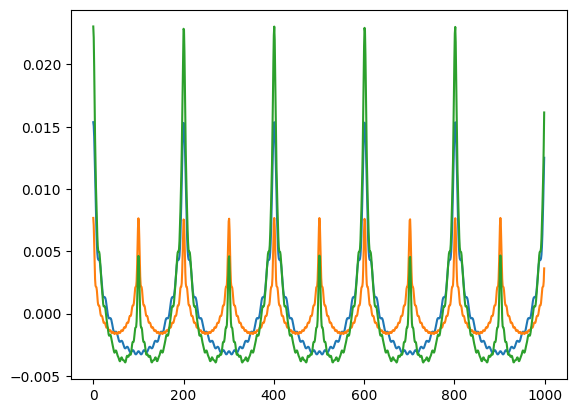

In [6]:
y220 = summed[220]
y440 = summed[440]
plt.plot(y220[0:1000])
plt.plot(y440[0:1000])
y = y220+y440
plt.plot(y[0:1000])

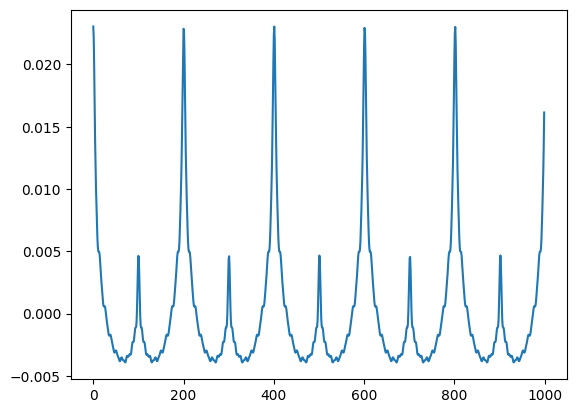

In [7]:
## TODO: Add together note and its octave, indexing the "summed"
# look above 
plt.plot(y[0:1000])
ipd.Audio(y, rate=sr)

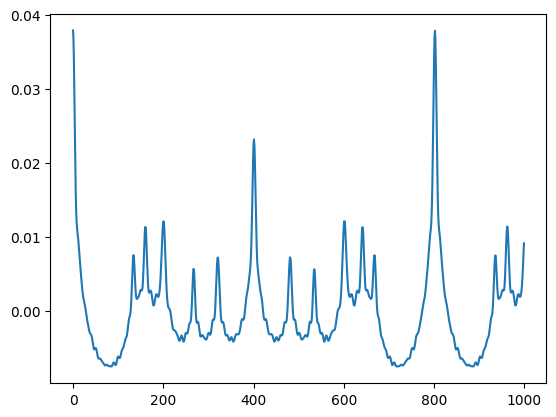

In [8]:
## TODO: Add together 220hz, 275hz, and 330hz
y220 = summed[220]
y275 = summed[275]
y330 = summed[330]
y = y220+y275+y330
plt.plot(y[0:1000])
ipd.Audio(y, rate=sr)

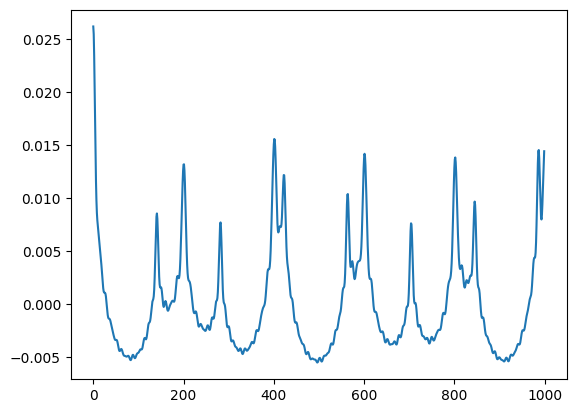

In [9]:
## TODO: Add together 220hz and 313hz
y220 = summed[220]
y313 = summed[313]
y = y220+y313
plt.plot(y[0:1000])
ipd.Audio(y, rate=sr)

# Part 2: Circle of Fifths
Now, you should construct 13 notes going in 3/2 intervals, starting at 440hz, but keep them in the interval between 440 and 880.  So if the frequency goes above 880, simply halve it to go an octave down.  This is known as the "circle of fifths"

In [43]:
rs = 44100
f = 440
ys = []
freqs = []
for i in range(13):
    ## TODO: Loop through and change f accordingly.
    ## Then, add each f to freqs, and add a sinusoid at
    ## that frequency to ys
    
    freqs.append(f)
    y = np.cos(2*np.pi*f*t)
    ys.append(y)
    f = f*3/2
    if f > 880:
        f = f/2

#TODO sort in order -> later now
summed = np.concatenate(ys) # all together for the circle
#ipd.Audio(summed, sr)
idx = np.argsort(freqs)
freqs = [freqs[i] for i in idx]
ys = [ys[i] for i in idx]
all_together = np.concatenate((ys))
ipd.Audio(summed, rate=sr)

tuples = [("Frequencies", freqs), ("Sinusoids", make_html_audio(ys, sr))]
df = pd.DataFrame(OrderedDict(tuples))
ipd.HTML(df.to_html(escape=False, float_format='%.2f'))


In [54]:
all_together = np.concatenate((ys))
ipd.Audio(all_together, rate=sr)

In [53]:
back_down = all_together[::-1]
y = np.concatenate((all_together, back_down))
ipd.Audio(y, rate=sr)

# Part 3: Inconsistency of The Circle of Fifths

The circle of fifths is supposed to cycle through the 12 unique notes in an octave.  But there is a discrepancy when we cycle all around, which is referred to as the <a href = "https://en.wikipedia.org/wiki/Pythagorean_comma">Pythagorean comma</a>. 

There's another issue that arises using these notes when we want to "transpose" a tune, or move it up or down by a constant amount of notes.  To see this, let's first sort the above notes so they are in frequency order.

In [29]:
idx = np.argsort(np.array(freqs[0:-1]))
freqs_sorted = np.array([freqs[i] for i in idx])
ys_sorted = [ys[i] for i in idx]
tuples = [("Frequencies", freqs_sorted), ("Sinusoids", make_html_audio(ys_sorted, sr))]
df = pd.DataFrame(OrderedDict(tuples))
ipd.HTML(df.to_html(escape=False, float_format='%.2f'))

Now let's construct the beginning of the happy birthday tune, starting at an A.  So putting together the sinusoids at index 0, 2, 0, 5, 4

In [39]:
## TODO: Construct the happy birthday tune into the numpy array "y"
## using the notes 0, 2, 0, 5, 4, which you can access as those indices in ys_sorted
y = np.concatenate((ys[0], ys[2], ys[0], ys[5], ys[4]))

ipd.Audio(y, rate=sr)

If we want to go up by a note, then we can use indices 1, 3, 1, 6, 5

In [46]:
## TODO: Construct the happy birthday tune into the numpy array "y"
## using the notes 1, 3, 1, 6, 5, which you can access as those indices in ys_sorted
y = np.concatenate((ys[1], ys[3], ys[1], ys[6], ys[5]))
ipd.Audio(y, rate=sr)

In [ ]:
## Look at the ratios
freqs_sorted[[1, 3, 1, 6, 5]] / freqs_sorted[[0, 2, 0, 5, 4]]

Let's now go back to the formula that we saw earlier for constructing notes on top of a base frequency.  This time, we'll use 440 as our base frequency to be consistent with the above example.  Let $p$ be how many halfsteps we are above the base frequency $f_0$. Then the formula is:

## $ f = f_0*2^{\frac{p}{12}} $

Notice now that if we move up by a constant amount of $k$, then the ratio between the notes is a constant $2^{k/12}$.  So they really would be the same tune, because they are multiplied by a constant frequency for each note, and, as we said in the beginning, a constant multiple leads to a constant shift in our perception.  Let's follow this formula to compare the notes we constructed

In [30]:
freqs_formula = 440*(2**(np.arange(12)/12))
ys_formula = [np.cos(2*np.pi*f*t) for f in freqs_formula]
tuples = [("Our Frequencies", freqs_sorted), ("Our Sinusoids", make_html_audio(ys_sorted, sr))]
tuples += [("Formula Frequencies", freqs_formula), ("Formula Sinusoids", make_html_audio(ys_formula, sr))]
df = pd.DataFrame(OrderedDict(tuples))
ipd.HTML(df.to_html(escape=False, float_format='%.2f'))